In [12]:
import os
# if using Apple MPS, fall back to CPU for unsupported ops
os.environ["PYTORCH_ENABLE_MPS_FALLBACK"] = "1"
os.environ["CUDA_LAUNCH_BLOCKING"] = "1"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image
import yaml 
Image.MAX_IMAGE_PIXELS = 9331200000

device = torch.device("cuda")

print(f"using device: {device}")

if device.type == "cuda":
    # use bfloat16 for the entire notebook
    torch.autocast("cuda", dtype=torch.bfloat16).__enter__()
    # turn on tfloat32 for Ampere GPUs (https://pytorch.org/docs/stable/notes/cuda.html#tensorfloat-32-tf32-on-ampere-devices)
    if torch.cuda.get_device_properties(0).major >= 8:
        torch.backends.cuda.matmul.allow_tf32 = True
        torch.backends.cudnn.allow_tf32 = True
elif device.type == "mps":
    print(
        "\nSupport for MPS devices is preliminary. SAM 2 is trained with CUDA and might "
        "give numerically different outputs and sometimes degraded performance on MPS. "
        "See e.g. https://github.com/pytorch/pytorch/issues/84936 for a discussion."
    )

np.random.seed(3)

def show_anns(anns, borders=True):
    if len(anns) == 0:
        return
    sorted_anns = sorted(anns, key=(lambda x: x['area']), reverse=True)
    ax = plt.gca()
    ax.set_autoscale_on(False)
    
    # Hide axes
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis('off')

    img = np.ones((sorted_anns[0]['segmentation'].shape[0], sorted_anns[0]['segmentation'].shape[1], 4))
    img[:, :, 3] = 0
    
    # Create a set of distinct colors for different classes
    np.random.seed(42)  # For consistent colors
    class_colors = {i: np.concatenate([np.random.random(3), [0.5]]) for i in class_names.keys()}
    
    for ann in sorted_anns:
        m = ann['segmentation']
        class_id = ann['predicted_class']
        class_name = class_names[class_id]
        
        # Use consistent color for the same class
        color_mask = class_colors[class_id]
        img[m] = color_mask
        
        if borders:
            import cv2
            contours, _ = cv2.findContours(m.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
            contours = [cv2.approxPolyDP(contour, epsilon=0.02, closed=True) for contour in contours]
            cv2.drawContours(img, contours, -1, (0, 0, 1, 0.4), thickness=1)
        
        # Add class label at the centroid of the mask
        if m.any():  # Only add label if mask is not empty
            moments = cv2.moments(m.astype(np.uint8))
            if moments['m00'] != 0:
                cx = int(moments['m10'] / moments['m00'])
                cy = int(moments['m01'] / moments['m00'])
                plt.text(cx, cy, class_name, 
                        color='white', fontsize=8, 
                        bbox=dict(facecolor='black', alpha=0.5),
                        ha='center', va='center')

    ax.imshow(img)
    
    # Add legend
    used_classes = set(ann['predicted_class'] for ann in sorted_anns)
    legend_elements = [plt.Rectangle((0, 0), 1, 1, fc=class_colors[i][:3], 
                                   label=class_names[i]) 
                      for i in used_classes]
    ax.legend(handles=legend_elements, 
             loc='center left', 
             bbox_to_anchor=(1, 0.5))

    # Remove margins
    plt.tight_layout()

# Load class mapping
def load_class_mapping(yaml_path):
    with open(yaml_path, 'r') as f:
        mapping = yaml.safe_load(f)
    return mapping['class_names']

class_names = load_class_mapping('/home/jovyan/ml-data-ptr/ptr-rd-mapscale-sam2-fork-exp1/mapping/class_mapping.yaml')

using device: cuda


In [13]:
from sam2.build_sam import build_sam2
from sam2.automatic_mask_generator import SAM2AutomaticMaskGenerator

sam2_checkpoint = "/home/jovyan/ml-data-ptr/sam2_exps/sam2_geojson_dataset_classification_base_lr_3e-4_vision_lr_6e-5_max_objects_32_frame_1/checkpoints/checkpoint.pt"
model_cfg = "configs/sam2.1/sam2.1_hiera_l.yaml"

sam2 = build_sam2(model_cfg, sam2_checkpoint, device='cuda:0', apply_postprocessing=False)

mask_generator = SAM2AutomaticMaskGenerator(
    model=sam2,
    points_per_side=32,
    points_per_batch=2,
    pred_iou_thresh=0.7,
    stability_score_thresh=0.92,
    stability_score_offset=0.7,
    crop_n_layers=2,
    box_nms_thresh=0.7,
    crop_n_points_downscale_factor=2,
    min_mask_region_area=25.0,
    use_m2m=True,
)

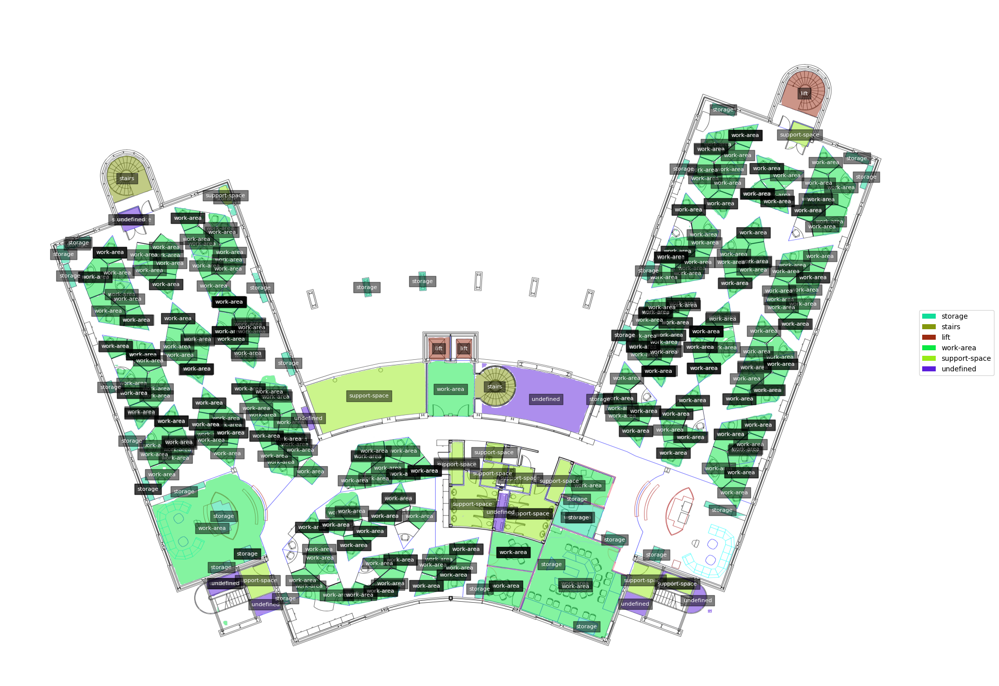

In [10]:
image = Image.open('images/SUN-DF_02_BOUND_bb0.png')
image = np.array(image.convert("RGB"))
masks2 = mask_generator.generate(image)
plt.figure(figsize=(20, 20))
plt.imshow(image)
show_anns(masks2)
plt.axis('off')
plt.show() 

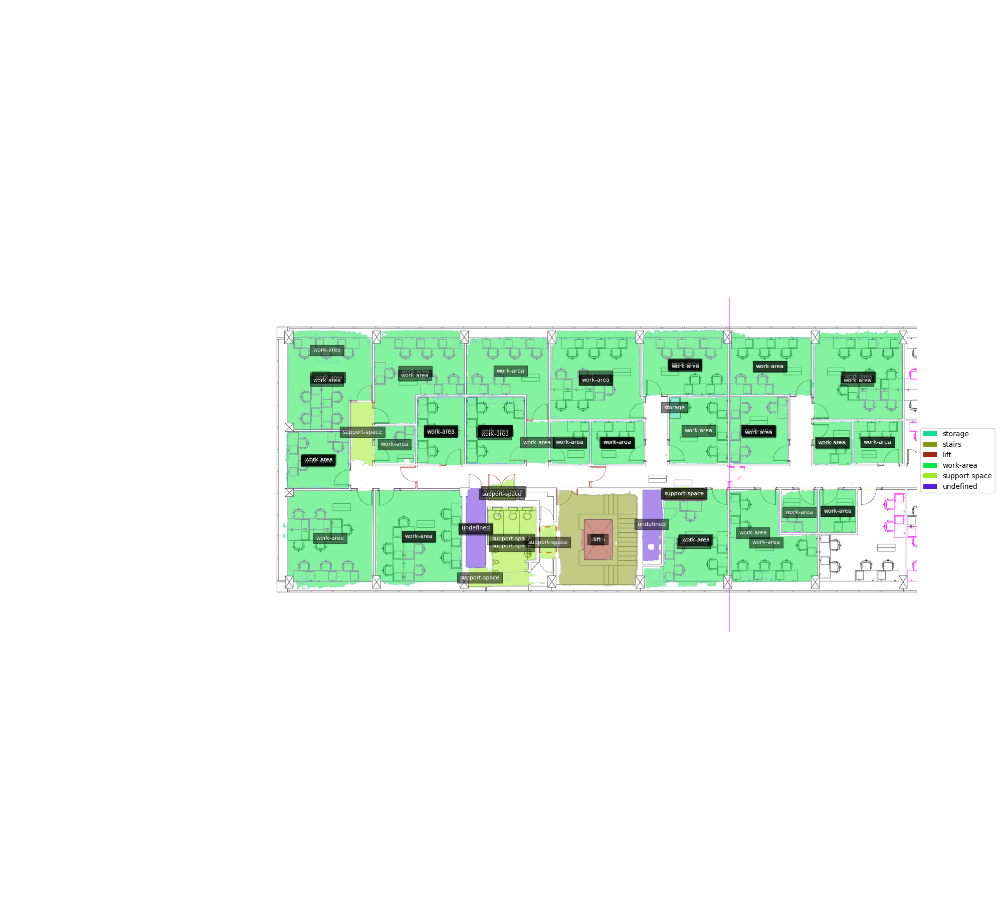

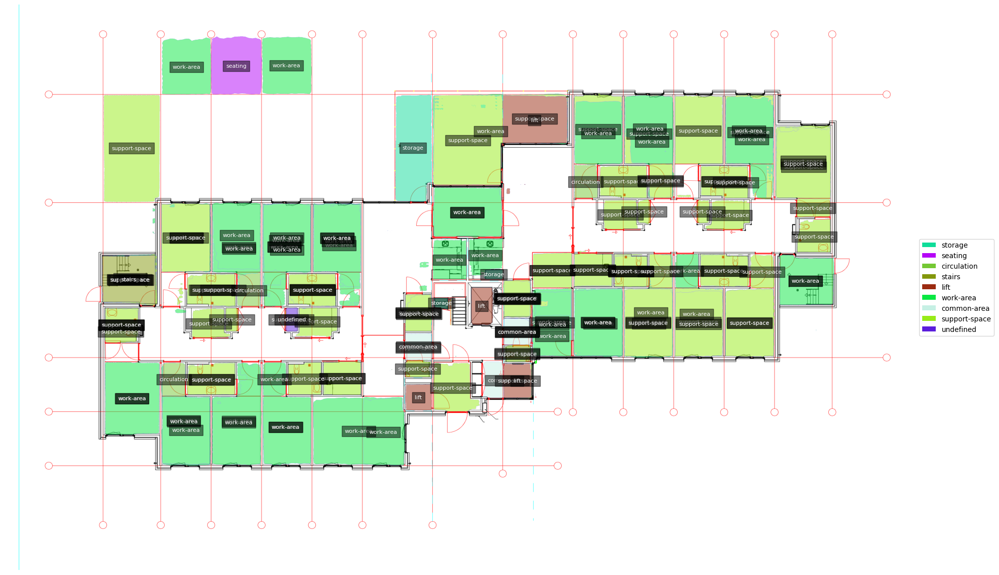

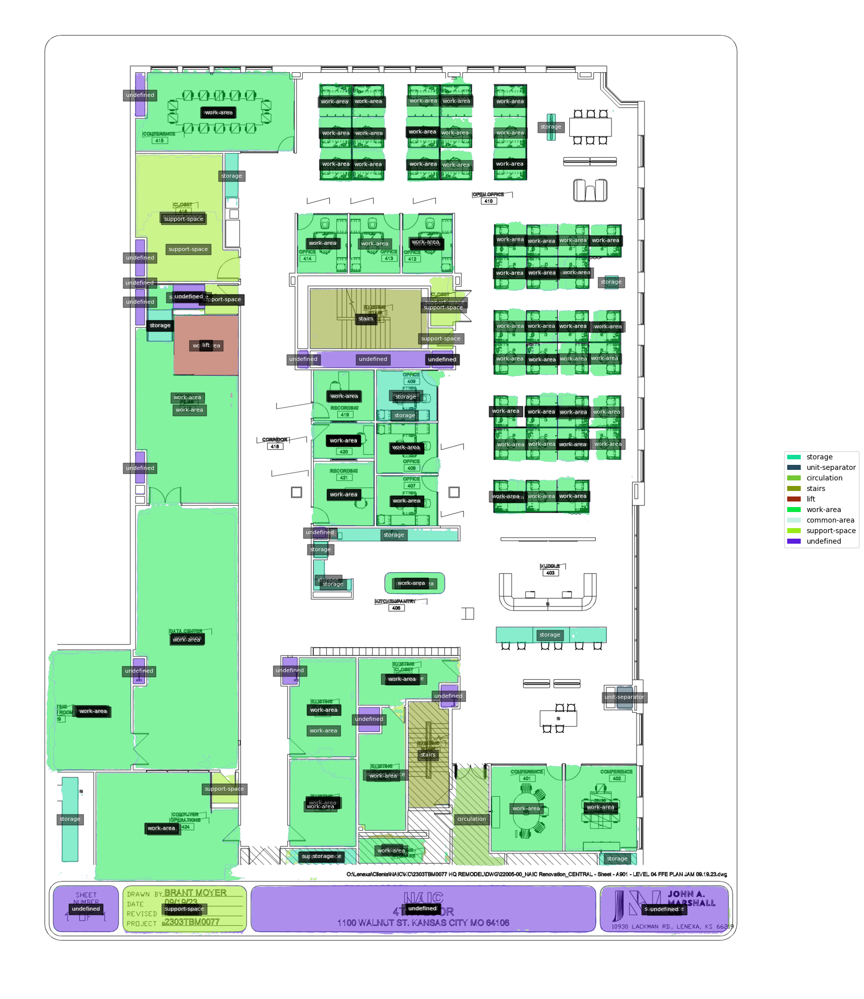

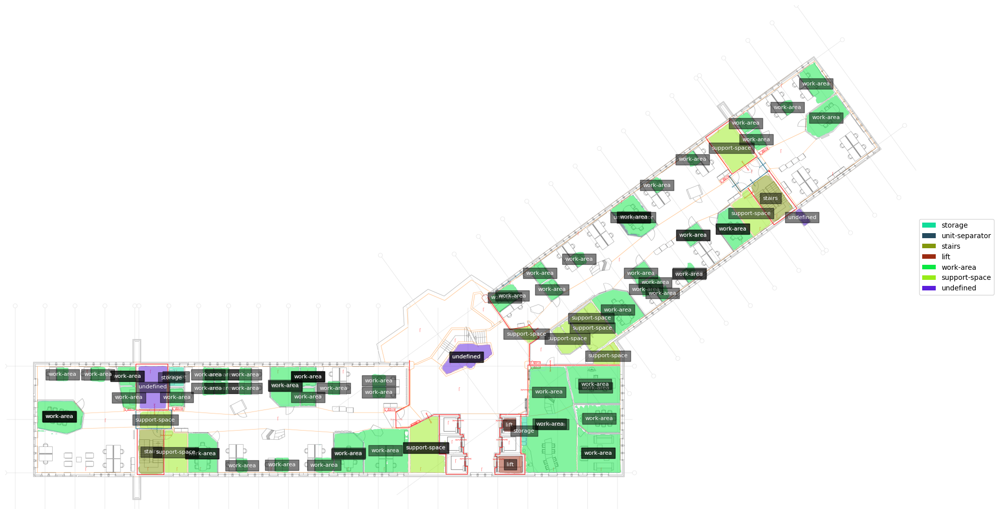

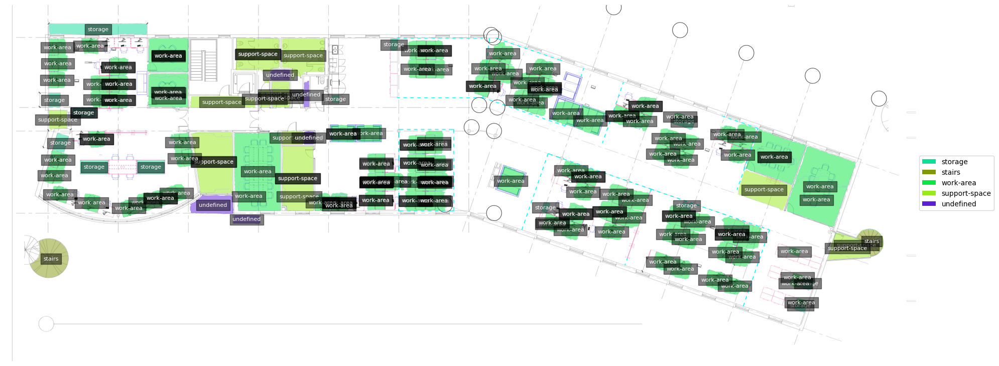

...

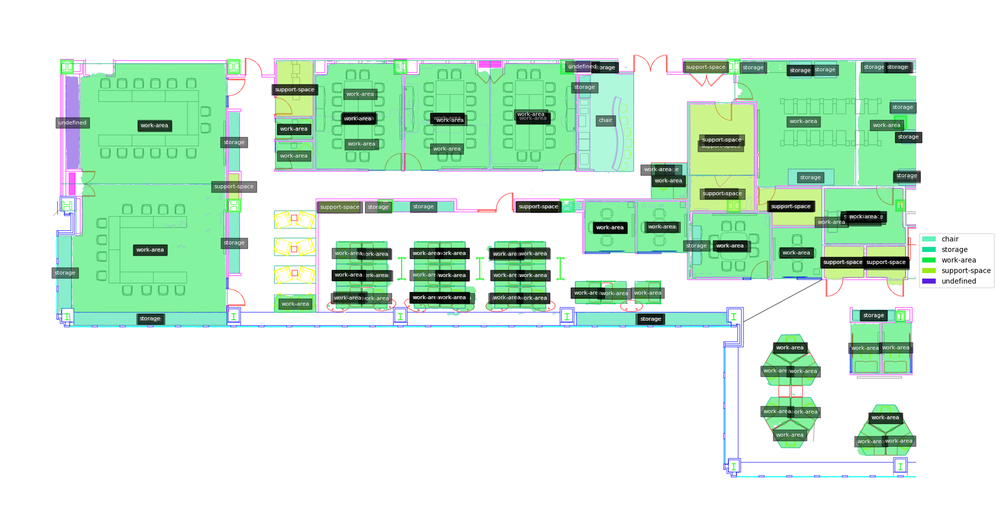

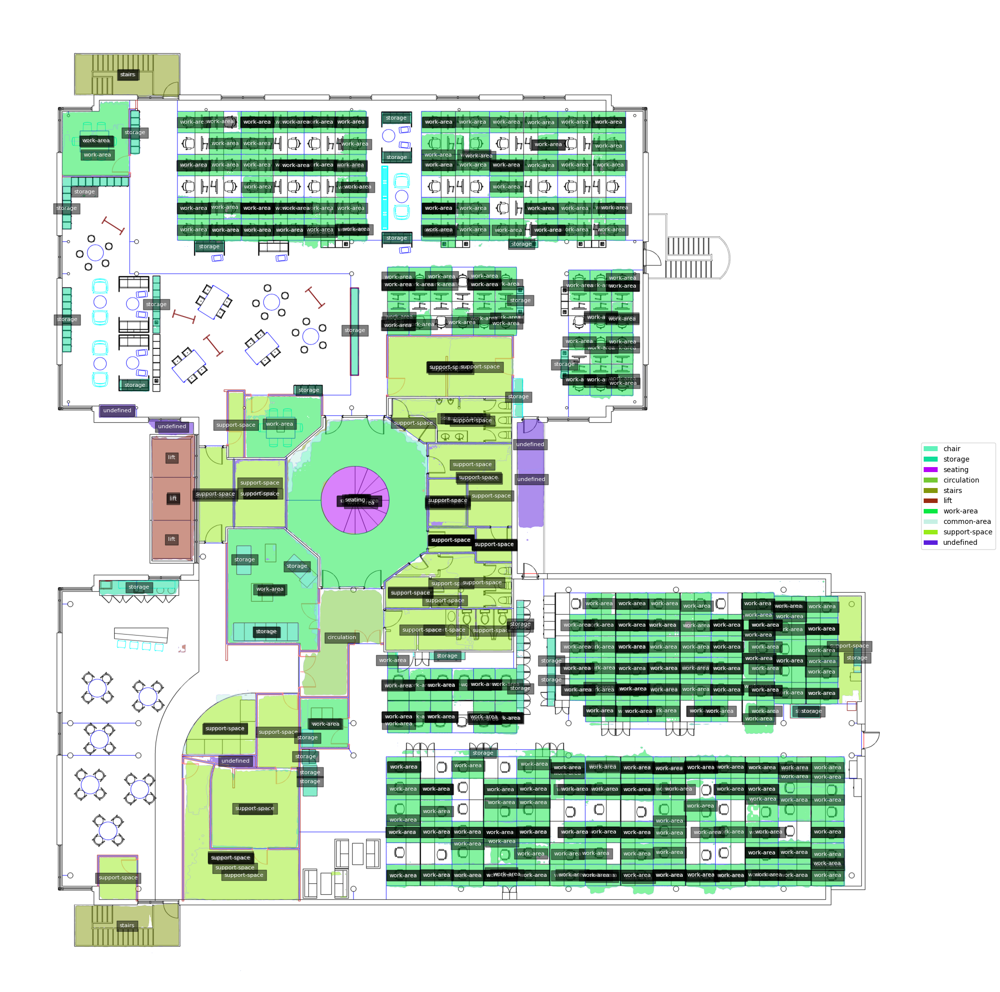

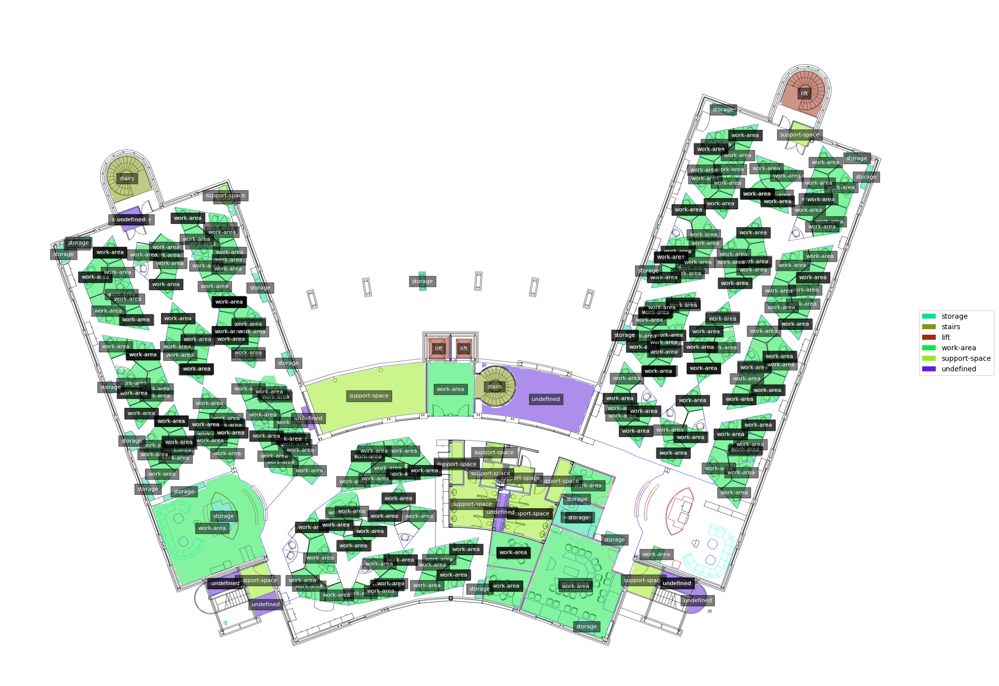

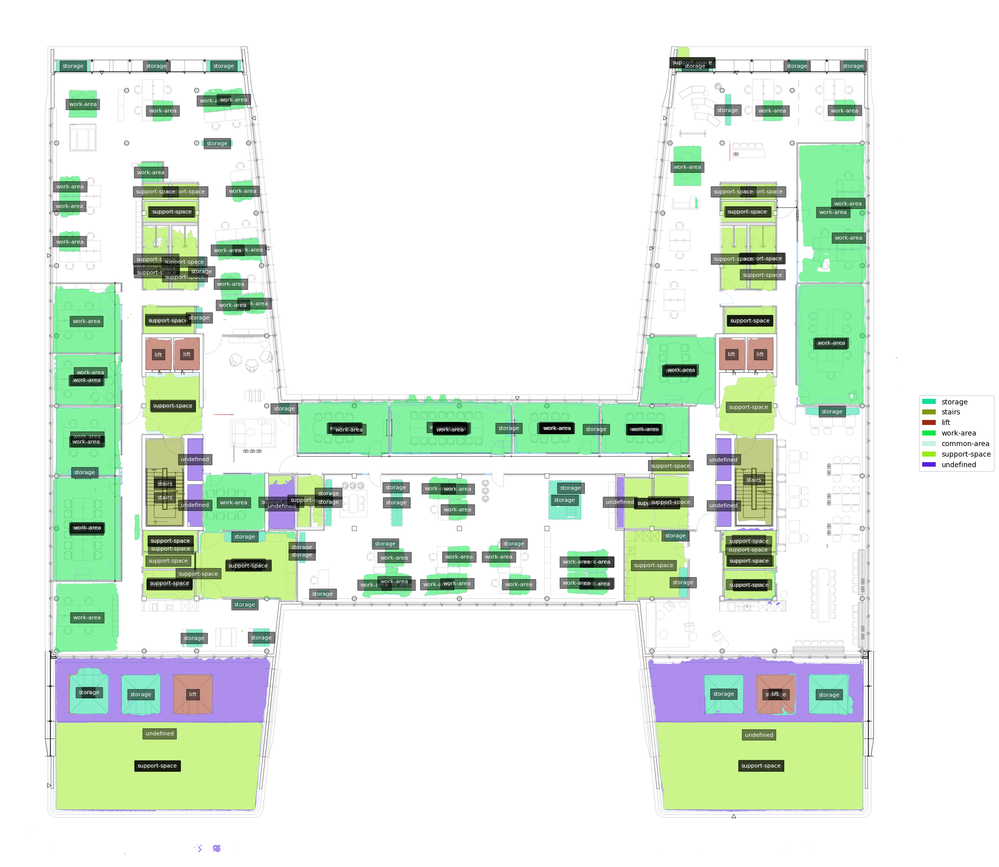

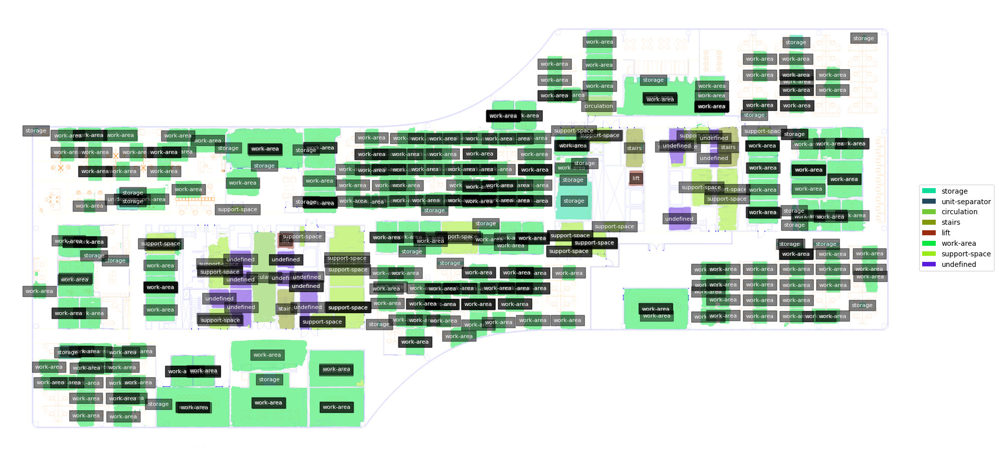

In [18]:
import glob 
test_files = glob.glob('images/*.png')
for path in test_files:
    # Load and convert image
    image = Image.open(path)
    image = np.array(image.convert("RGB"))
    masks2 = mask_generator.generate(image)
    plt.figure(figsize=(20, 20))
    plt.imshow(image)
    show_anns(masks2)
    plt.axis('off')
    plt.show() 